In [1]:
import numpy as np
import cv2 as cv
import glob
import pickle
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt


# 1. Camera Calibration

**Image Collection (50 images)**

https://drive.google.com/drive/folders/1doNgMdEPy9rP4rxpF5zZ18gt3SZYMjfQ?usp=sharing

Note: This dataset is uploaded in the temporary workspace. I am not sourcing it from drive.

**Image Calibration Pipeline:**

1. First, we collect/store images containing the chessboard pattern in a slightly different pose. These images will be used for calibration.

2. Next, we perform corner detection on the images one-by-one. We use opencv's findChessboardCorners() to get the corners. Upon this, we use cornerSubPlix() to further refine our measurement.

3. We then generate object points which represent the detected corners of image.

4. We then extract points in image that correspond to the detected corners in the image.

5. We then perform calibration using calibrateCamera(). Here, we get the camera matrix and other distortion values.

6. Using the undistort() we then undistort each image using the paramters we got in previous step.

7. We also calculate reprojection error for each image and plot them.




**Corner Detection**

In [ ]:


# Initialize sizes
size_of_image_frame = (640,480)
size_of_chess_board = (8,6)


# storing points

# 2d image points
image_points_list = []
# 3d points
object_points_list = []


image_frames_strings = glob.glob('frames_new/*.jpg')

siz = size_of_chess_board[0] * size_of_chess_board[1]
points_object = np.zeros((siz, 3), np.float32)
points_object[:,:2] = np.mgrid[0:size_of_chess_board[0],0:size_of_chess_board[1]].T.reshape(-1,2)

original_images = []
image_number = 1

# criteria for termination
op1 = 30
op2 = 0.001
terminate_criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, op1, op2)


for image_string in image_frames_strings:

    read_image = cv.imread(image_string)
    image_grayed = cv.cvtColor(read_image, cv.COLOR_BGR2GRAY)

    # Corner detection
    crnr_flag, extracted_crnrs = cv.findChessboardCorners(image_grayed, size_of_chess_board, None)

    # refine crnr points and add to list
    if crnr_flag == True:

        object_points_list.append(points_object)
        refined_crnrs = cv.cornerSubPix(image_grayed, extracted_crnrs, (15,15), (-1,-1), terminate_criteria)
        image_points_list.append(extracted_crnrs)

        # Display
        print ("Original Image "+ str(image_number))

        # Draw corners
        cv.drawChessboardCorners(read_image, size_of_chess_board, refined_crnrs, crnr_flag)
        cv2_imshow(read_image)
        image_number +=1
        original_images.append(read_image)



cv.destroyAllWindows()


**CALIBRATION**

In [3]:

crnr_flag, mtx_of_cam, dstrtn, rot_vec, trans_vec = cv.calibrateCamera(object_points_list, image_points_list, size_of_image_frame, None, None)
print("Camera Matrix")
print (mtx_of_cam)


Camera Matrix
[[574.9352918    0.         358.05887887]
 [  0.         578.98317699 212.26982973]
 [  0.           0.           1.        ]]


**UNDISTORTION**

In [ ]:

processed_images =[]
processed_points =[]
for image in image_frames_strings:
  read_image = cv.imread(image)
  hgt,  wth = read_image.shape[:2]
  mtx_of_cam_2, rgn_intrst = cv.getOptimalNewCameraMatrix(mtx_of_cam, dstrtn, (wth,hgt), 1, (wth,hgt))


  # image undistortion
  undistrtd_img = cv.undistort(read_image, mtx_of_cam, dstrtn, None, mtx_of_cam_2)

  x, y, wth, hgt = rgn_intrst
  undistrtd_img = undistrtd_img[y:y+hgt, x:x+wth]
  undistrtd_img= cv.resize(undistrtd_img, (640, 480))

  image_grayed = cv.cvtColor(undistrtd_img, cv.COLOR_BGR2GRAY)

  # chess board corners finding
  crnr_flag, extracted_crnrs = cv.findChessboardCorners(image_grayed, size_of_chess_board, None)

  if crnr_flag == True:


      refined_crnrs = cv.cornerSubPix(image_grayed, extracted_crnrs, (15,15), (-1,-1), terminate_criteria)
      processed_points.append(refined_crnrs)
      # Draw
      cv.drawChessboardCorners(undistrtd_img, size_of_chess_board, refined_crnrs, crnr_flag)
      processed_images.append (undistrtd_img)

image_number = 0


for ori_ig, prc_ig in zip(original_images, processed_images):
  ht = min(ori_ig.shape[0], prc_ig.shape[0])
  ori_ig = ori_ig[:ht, :]
  prc_ig = prc_ig[:ht, :]

  # Concatenate horizontally
  left_right_img = cv.hconcat([ori_ig, prc_ig])
  print ("Frame number "+ str(image_number) +" | Original vs Undistorted Image")
  cv2_imshow(left_right_img)
  image_number+=1

**REPROJECTION ERROR**

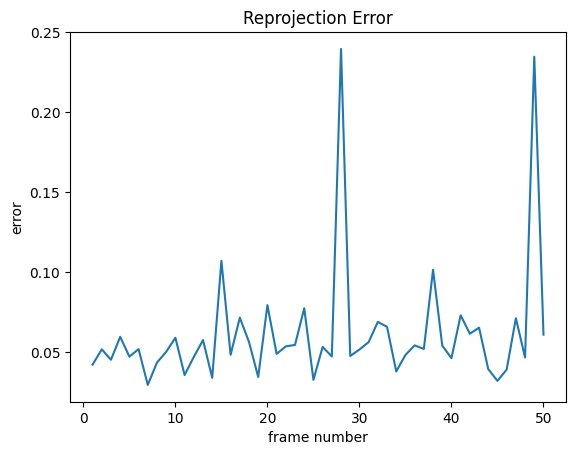

In [5]:
# Calculating reprojection error


errors_list = []
iteration = range(len(object_points_list))
for it in iteration:
    pt, h = cv.projectPoints(object_points_list[it], rot_vec[it], trans_vec[it], mtx_of_cam, dstrtn)
    rr = cv.norm(image_points_list[it], pt, cv.NORM_L2)/len(pt)
    errors_list.append(round(rr,5))

frame_numbers = range (1,51)

# Plotting
plt.plot(frame_numbers, errors_list)

plt.xlabel('frame number')
plt.ylabel('error')
plt.title('Reprojection Error')
plt.show()


# 2. Stereo Vision


**helper functions**

In [12]:
# This fn computes epipolar lines and displays them
def get_lns_epipolar(p1, p2, mat_F, ig_lft, ig_rgt):

    ln1=[]
    ln2=[]
    epi_ig_l = ig_lft.copy()
    epi_ig_r = ig_rgt.copy()

    for itr in range(p1.shape[0]):
        x_a = np.array([p1[itr,0], p1[itr,1], 1]).reshape(3,1)
        x_b = np.array([p2[itr,0], p2[itr,1], 1]).reshape(3,1)
        ln_l_2 = np.dot(mat_F, x_a)
        ln2.append(ln_l_2)
        ln_l_1 = np.dot(mat_F.T, x_b)
        ln1.append(ln_l_1)
        m_x_2 = 0
        M_x_2 = ig_rgt.shape[1] - 1
        m_y_2 = -ln_l_2[2]/ln_l_2[1]
        M_y_2 = -ln_l_2[2]/ln_l_2[1]
        m_x_1 = 0
        M_x_1 = ig_lft.shape[1] -1
        m_y_1 = -ln_l_1[2]/ln_l_1[1]
        M_y_1 = -ln_l_1[2]/ln_l_1[1]

        # Draw blue circle on the points and yellow-red line
        cv.circle(epi_ig_r, (int(p2[itr,0]),int(p2[itr,1])), 11, (249,0,0), -1)
        cv.circle(epi_ig_l, (int(p1[itr,0]),int(p1[itr,1])), 11, (249,0,0), -1)
        epi_ig_r = cv.line(epi_ig_r, (int(m_x_2), int(m_y_2)), (int(M_x_2), int(M_y_2)), (0,254,254), 2)
        epi_ig_l = cv.line(epi_ig_l, (int(m_x_1), int(m_y_1)), (int(M_x_1), int(M_y_1)), (0,254,254), 2)

        igs=[epi_ig_l, epi_ig_r]
        szs = []
        for ige in igs:
            x_val, y_val, ch_val = ige.shape
            szs.append([x_val, y_val, ch_val])

        szs = np.array(szs)
        trg_x, trg_y, filler = np.max(szs, axis = 0)

        igs_rsd = []

        for itr, ige in enumerate(igs):
            ig_rsd = np.zeros((trg_x, trg_y, szs[itr, 2]), np.uint8)
            ig_rsd[0:szs[itr, 0], 0:szs[itr, 1], 0:szs[itr, 2]] = ige
            igs_rsd.append(ig_rsd)
    ig1, ig2 = igs_rsd
    ig_grp = np.concatenate((ig1, ig2), axis = 1)
    #ig_grp = cv.resize(ig_grp, (960, 330))
    print()
    print ("Epipolar lines")
    cv2_imshow(ig_grp)


#This fn computes normalised value of x and y
def normalise(val):
    val1 = np.mean(val, axis=0)
    x1  = val1[0]
    y1 = val1[1]
    x2 = val[:,0] - x1
    y2 = val[:,1] - y1
    distance = np.mean(np.sqrt(x2**2 + y2**2))
    scle = np.diag([2/distance,2/distance,1])
    mat_t = np.array([[1,0,-x1],[0,1,-y1],[0,0,1]])
    mat_T = scle.dot(mat_t)
    x3 = np.column_stack((val, np.ones(len(val))))
    x3_n = (mat_T.dot(x3.T)).T
    return  x3_n, mat_T


# This fn gets us the x val from line eqn
def x_get(ln, corresponding_y):
    val_a= ln[0]
    val_b = ln[1]
    val_c = ln[2]
    k1 = val_b*corresponding_y
    final_x = -(k1 + val_c)/val_a
    return final_x




# This fn gets us fundamental mtx
def get_F(mtchd_ftrs):

    x_A = mtchd_ftrs[:,0:2]
    x_B = mtchd_ftrs[:,2:4]
    if x_A.shape[0] > 7:
        n_xA, mtx_T_1 = normalise(x_A)
        n_xB, mtx_T_2 = normalise(x_B)
        mtx_A = np.zeros((len(n_xA),9))
        for itr in range(0, len(n_xA)):
            x1,y1 = n_xA[itr][0], n_xA[itr][1]
            x2,y2 = n_xB[itr][0], n_xB[itr][1]
            mtx_A[itr] = np.array([x1*x2, x2*y1, x2, y2*x1, y2*y1, y2, x1, y1, 1])
        f1,f2, mtx_V_T = np.linalg.svd(mtx_A, full_matrices=True)
        mtx_F = mtx_V_T.T[:, -1]
        mtx_F = mtx_F.reshape(3,3)
        mtx_u, mtx_s, mtx_v_t = np.linalg.svd(mtx_F)
        mtx_s = np.diag(mtx_s)
        mtx_s[2,2] = 0
        mtx_F = np.dot(mtx_u, np.dot(mtx_s, mtx_v_t))
        mtx_F = np.dot(mtx_T_2.T, np.dot(mtx_F, mtx_T_1))
        return mtx_F

    else:
        return None


# This fn computes error in epipolar points
def error_epi(ftrs, mtx_F):
    x__a,x__b = ftrs[0:2], ftrs[2:4]
    x__a_t=np.array([x__a[0], x__a[1], 1]).T
    x__b_t=np.array([x__b[0], x__b[1], 1])
    err = np.dot(x__a_t, np.dot(mtx_F, x__b_t))
    return np.abs(err)

# RANSAC algorithm
def algo_ransac(ftrs):

    trshd_inlier = 0
    points_fit_max = []
    mtx_f = 0

    for itr_i in range(0, 1000):
        indi = []
        #we check best fit by selecting 8 ransom points
        row_number = ftrs.shape[0]
        rando_ids = np.random.choice(row_number, size=8)
        c_best = ftrs[rando_ids, :]
        got_f_best = get_F(c_best)

        #we threshold (0.02) indices error
        for itr_j in range(row_number):
            extracted_ftr = ftrs[itr_j]
            err = error_epi(extracted_ftr, got_f_best)
            if err < 0.02:
                indi.append(itr_j)

        #we select best F mtx
        if len(indi) > trshd_inlier:
            trshd_inlier = len(indi)
            points_fit_max = indi
            mtx_f = got_f_best

    ftrs_important = ftrs[points_fit_max, :]
    return mtx_f, ftrs_important


# This fn returns 2d pixel values from 3d point
def get_pixels(pxl_in_3d,trs_,rot_3):
    pixels = 0
    for pose_itr in pxl_in_3d:
        pose_itr = pose_itr.reshape(-1,1)
        if rot_3.dot(pose_itr - trs_) > 0 and pose_itr[2]>0:
            pixels+=1
    return pixels

 **Main compute function**

In [7]:
def compute(cam1_K, cam2_K, other_parameters, img_name):

    ### Get image data ###
    image_a = cv.imread(img_name+ '/im0.png')
    image_b = cv.imread(img_name+ '/im1.png')
    focal_length = cam1_K[0,0]
    baseline_value = other_parameters[1]

    ### Calibrate ###

    # sift for keypoint detection
    sift_object = cv.SIFT_create()
    i0 = image_a
    i1 = image_b

    i0g = cv.cvtColor(i0, cv.COLOR_BGR2GRAY)
    i1g = cv.cvtColor(i1, cv.COLOR_BGR2GRAY)

    key_points_1, descriptions_1 = sift_object.detectAndCompute(i0g, None)
    key_points_2, descriptions_2 = sift_object.detectAndCompute(i1g, None)

    # brute force feature matching
    matcher = cv.BFMatcher()
    got_matches = matcher.match(descriptions_1,descriptions_2)
    got_matches = sorted(got_matches, key = lambda x :x.distance)
    matches_sampling = 100
    filtered_matches = got_matches[:matches_sampling]

    feature_mtcd_images = cv.drawMatches(i0,key_points_1,i1,key_points_2,got_matches[:100],None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    print ("Feature matched images")
    cv2_imshow(feature_mtcd_images)

    corresponding_match = []
    for itr, match_1 in enumerate(filtered_matches):
        p1 = key_points_1[match_1.queryIdx].pt
        p2 = key_points_2[match_1.trainIdx].pt
        corresponding_match.append([p1[0], p1[1], p2[0], p2[1]])
        pair_of_arr = np.array(corresponding_match).reshape(-1, 4)
    corresponding_match = pair_of_arr
    matched_pairs = corresponding_match


    # Fundamental matrix calculation / using ransac
    finest_F, points_crrspnd_best = algo_ransac(matched_pairs)

    # Essential matrix calculation

    mtx_E = cam2_K.T.dot(finest_F).dot(cam1_K)
    mtx_u,mtx_s,mtx_v = np.linalg.svd(mtx_E)
    mtx_s = [1,1,0]
    updated_E_mtx = np.dot(mtx_u,np.dot(np.diag(mtx_s),mtx_v))

    E = updated_E_mtx
    print ()
    print('Fundamental mtx')
    print (finest_F)
    print ()
    print('Essential mtx')
    print (E)

    # compute 3d pose of points
    mtx_u, mtx_s, mtx_vt = np.linalg.svd(E)
    mtx_w = np.array([[0, -1, 0], [1, 0, 0], [0, 0, 1]])

    component_r = []
    component_t = []

    # rotational configuration
    component_r.append(np.dot(mtx_u, np.dot(mtx_w, mtx_vt)))
    component_r.append(np.dot(mtx_u, np.dot(mtx_w, mtx_vt)))
    component_r.append(np.dot(mtx_u, np.dot(mtx_w.T, mtx_vt)))
    component_r.append(np.dot(mtx_u, np.dot(mtx_w.T, mtx_vt)))

    # translational configuration
    velue = 2
    component_t.append(mtx_u[:,velue])
    component_t.append(-mtx_u[:,velue])
    component_t.append(mtx_u[:,velue])
    component_t.append(-mtx_u[:,velue])

    # get best config of cameras
    for itr in range(0,4):
        if (np.linalg.det(component_r[itr]) < 0):
            component_r[itr] = -component_r[itr]
            component_t[itr] = -component_t[itr]

    rot_2 = component_r
    trs_2  = component_t
    pxl_in_3d = []
    rot_1  = np.identity(3)
    trs_1  = np.zeros((3, 1))
    mtx_identitiy = np.identity(3)

    # perform triangulation
    for itr in range(len(rot_2)):
        rot2 =  rot_2[itr]
        trs2 =   trs_2[itr].reshape(3,1)
        ig0_projection = np.dot(cam1_K, np.dot(rot_1, np.hstack((mtx_identitiy, -trs_1.reshape(3,1)))))
        ig1_projection = np.dot(cam2_K, np.dot(rot2, np.hstack((mtx_identitiy, -trs2.reshape(3,1)))))
        for point_x_ig0,point_x_ig1 in zip(points_crrspnd_best[:,0:2], points_crrspnd_best[:,2:4]):
            points_in_3d_plane = cv.triangulatePoints(ig0_projection, ig1_projection, np.float32(point_x_ig0), np.float32(point_x_ig1))
            points_in_3d_plane = np.array(points_in_3d_plane)
            points_in_3d_plane = points_in_3d_plane[0:3,0]
            pxl_in_3d.append(points_in_3d_plane)
    best_px_numbers = 0
    highest_val = 0

    # restore camera pose
    for itr in range(len(rot_2)):
        rot_, trs_ = rot_2[itr],  trs_2[itr].reshape(-1,1)
        rot_3 = rot_[2].reshape(1,-1)

        pixels = 0
        for pose_itr in pxl_in_3d:
            pose_itr = pose_itr.reshape(-1,1)
            if rot_3.dot(pose_itr - trs_) > 0 and pose_itr[2]>0:
                pixels+=1
        pos_val = pixels
        if pos_val > highest_val:
            best_px_numbers = itr
            highest_val = pos_val

    rot_config, trans_config, p3dattn = rot_2[best_px_numbers], trs_2[best_px_numbers], pxl_in_3d[best_px_numbers]
    print ()
    print("Translation mtx")
    print (trans_config)
    print()
    print("Rotation mtx")
    print (rot_config)
    print()

    ### Rectify ###

    pts_set1,pts_set2= points_crrspnd_best[:,0:2], points_crrspnd_best[:,2:4]

    hgt1, wgt1 = i0.shape[:2]
    hgt2, wgt2 = i1.shape[:2]
    filler, homo_1, homo_2 = cv.stereoRectifyUncalibrated(np.float32(pts_set1), np.float32(pts_set2), finest_F, imgSize=(wgt1, hgt1))
    print("Homography mtx 1")
    print (homo_1)
    print()
    print ("Homography mtx 2")
    print (homo_2)
    print()
    rectified_i1 = cv.warpPerspective(i0, homo_1, (wgt1, hgt1))
    rectified_i2 = cv.warpPerspective(i1, homo_2, (wgt2, hgt2))
    perspective_rectified1 = cv.perspectiveTransform(pts_set1.reshape(-1, 1, 2), homo_1).reshape(-1,2)
    perspective_rectified2 = cv.perspectiveTransform(pts_set2.reshape(-1, 1, 2), homo_2).reshape(-1,2)

    homo2_inverse =  np.linalg.inv(homo_2.T)
    homo1_inverse = np.linalg.inv(homo_1)
    Fundamental_mtx_rctfd = np.dot(homo2_inverse, np.dot(finest_F, homo1_inverse))

    get_lns_epipolar(perspective_rectified1, perspective_rectified2, Fundamental_mtx_rctfd, rectified_i1, rectified_i2)

    ig1_rr = cv.resize(rectified_i1, (int(rectified_i1.shape[1] / 4), int(rectified_i1.shape[0] / 4)))
    ig2_rr = cv.resize(rectified_i2, (int(rectified_i2.shape[1] / 4), int(rectified_i2.shape[0] / 4)))
    ig1_rr = cv.cvtColor(ig1_rr, cv.COLOR_BGR2GRAY)
    ig2_rr = cv.cvtColor(ig2_rr, cv.COLOR_BGR2GRAY)


    # calculating disparity
    rectified_ig_lft, rectified_ig_rgt = ig1_rr, ig2_rr

    rectified_ig_lft = rectified_ig_lft.astype(int)
    rectified_ig_rgt = rectified_ig_rgt.astype(int)

    hhgt, wwdth = rectified_ig_lft.shape
    mtx_disprity = np.zeros((hhgt, wwdth))
    size_wdw = 5
    x_nw = wwdth-(2*size_wdw)

    # matching blocks
    for itr_y in range(size_wdw, hhgt-size_wdw):
        rt_ig_lft_b = []
        rt_ig_rgt_b = []
        for itr_x in range(size_wdw, wwdth-size_wdw):
            blk_lft = rectified_ig_lft[itr_y:itr_y+size_wdw,itr_x:itr_x +size_wdw]
            rt_ig_lft_b.append(blk_lft.flatten())
            blk_rgt = rectified_ig_rgt[itr_y:itr_y+size_wdw,itr_x:itr_x +size_wdw]
            rt_ig_rgt_b.append(blk_rgt.flatten())

        rt_ig_lft_b = np.array(rt_ig_lft_b)
        rt_ig_rgt_b = np.array(rt_ig_rgt_b)
        rt_ig_lft_b = np.repeat(rt_ig_lft_b[:,:,np.newaxis],x_nw,axis=2)
        rt_ig_rgt_b = np.repeat(rt_ig_rgt_b[:,:,np.newaxis],x_nw,axis=2)
        rt_ig_rgt_b = rt_ig_rgt_b.T

        diff_val = np.abs(rt_ig_lft_b - rt_ig_rgt_b)
        sum_of_diff = np.sum(diff_val, axis = 1)
        px_no = np.argmin(sum_of_diff, axis = 0)
        dis_parity = np.abs(px_no - np.linspace(0, x_nw, x_nw, dtype=int)).reshape(1, x_nw)
        mtx_disprity[itr_y, 0:x_nw] = dis_parity


    # using matplotlib to plot and save disparity maps
    dimensions = mtx_disprity * 255 / np.max(mtx_disprity)
    disparity_map_step = np.uint8(dimensions)

    fig, axes = plt.subplots(2, 2)
    forr1 = 'hot'
    inte1 = 'nearest'
    axes[0,0].imshow(disparity_map_step, cmap=forr1, interpolation=inte1)
    axes[0,0].set_title('Heated disparity')
    axes[0,0].axis('off')
    forr2 = 'gray'
    inte2 = 'nearest'
    axes[0,1].imshow(disparity_map_step, cmap=forr2, interpolation=inte2)
    axes[0,1].set_title('Greyed disparity')
    axes[0,1].axis('off')


    ### Depth ###

    depth_val = (baseline_value * focal_length) / (mtx_disprity + 1e-10)
    threshold_depth = 1000*100
    depth_val[depth_val > threshold_depth] = threshold_depth


    # plotting using matplotlib
    map_of_depth = np.uint8(depth_val * 255 / np.max(depth_val))
    axes[1,0].imshow(map_of_depth, cmap=forr1, interpolation=inte1)
    axes[1,0].set_title('Heated depth')
    axes[1,0].axis('off')
    axes[1,1].imshow(map_of_depth, cmap=forr2, interpolation=inte2)
    axes[1,1].set_title('Greyed depth')
    axes[1,1].axis('off')
    plt.savefig(img_name + "_output.png")
    plt.tight_layout()
    plt.show()

**Calling the compute fn for each dataset**

Note: The dataset folders are uploaded to the temporary workspace one-by-one.
The output image consisting of disparity and depth maps are stored similar to "classroom_output.png"


**CLASSROOM**

Feature matched images


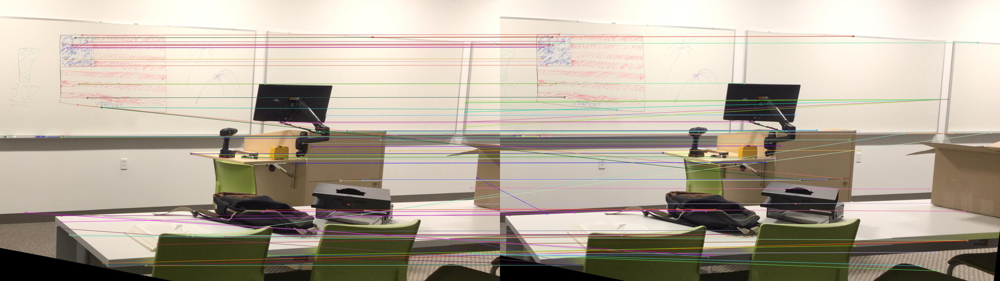


Fundamental mtx
[[-1.19776230e-10 -2.39022029e-08 -6.05430788e-06]
 [ 4.13205976e-08 -4.15109937e-08  2.39005950e-03]
 [-1.44367061e-06 -2.36674831e-03  2.63376754e-03]]

Essential mtx
[[-9.68469832e-05 -1.75878816e-02 -8.21986139e-03]
 [ 3.03102764e-02 -1.47750231e-02  9.99399636e-01]
 [ 8.15620309e-03 -9.99699122e-01 -1.48857885e-02]]

Translation mtx
[-0.99981153 -0.0079595   0.0177075 ]

Rotation mtx
[[ 9.99920515e-01  3.83764202e-04 -1.26022666e-02]
 [-1.97372222e-04  9.99890628e-01  1.47882679e-02]
 [ 1.26065635e-02 -1.47846051e-02  9.99811227e-01]]

Homography mtx 1
[[-2.27112238e-03  3.15175652e-05  1.36662174e-01]
 [-1.54339174e-06 -2.36668312e-03 -3.13301350e-03]
 [-4.09205884e-08  4.09201442e-08 -2.36691536e-03]]

Homography mtx 2
[[ 1.00961197e+00  8.02094811e-03 -1.35588000e+01]
 [-2.51985240e-03  1.00001154e+00  2.41282750e+00]
 [ 1.00453369e-05  7.98060328e-08  9.90313381e-01]]



<ipython-input-6-16d411ad1c21>:28: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  epi_ig_r = cv.line(epi_ig_r, (int(m_x_2), int(m_y_2)), (int(M_x_2), int(M_y_2)), (0,254,254), 2)
<ipython-input-6-16d411ad1c21>:29: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  epi_ig_l = cv.line(epi_ig_l, (int(m_x_1), int(m_y_1)), (int(M_x_1), int(M_y_1)), (0,254,254), 2)



Epipolar lines


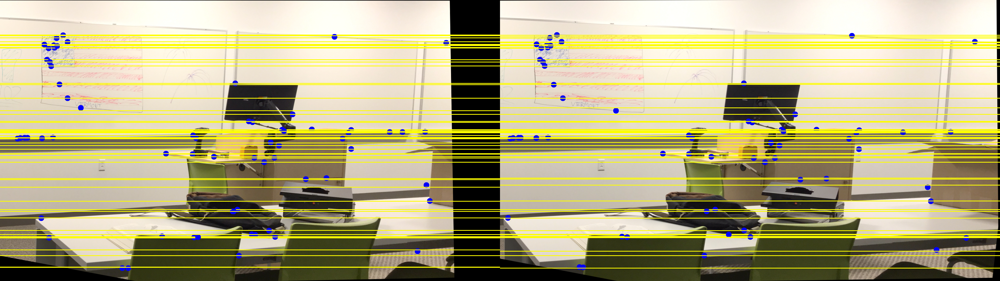

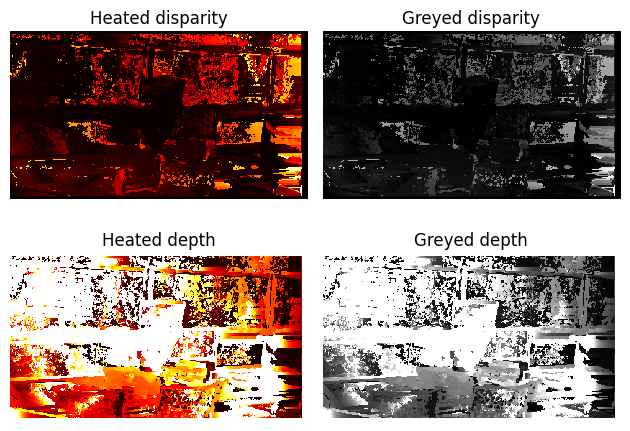

In [8]:
cam1_K = np.array([[1746.24, 0, 14.88], [0 ,1746.24, 534.11], [0, 0, 1]])
cam2_K = np.array([[1746.24, 0, 14.88], [0 ,1746.24, 534.11], [0, 0, 1]])

other_parameters = [0,678.37,1920,1080,310,60,280]
compute(cam1_K, cam2_K, other_parameters, "classroom")

**STORAGEROOM**

Feature matched images


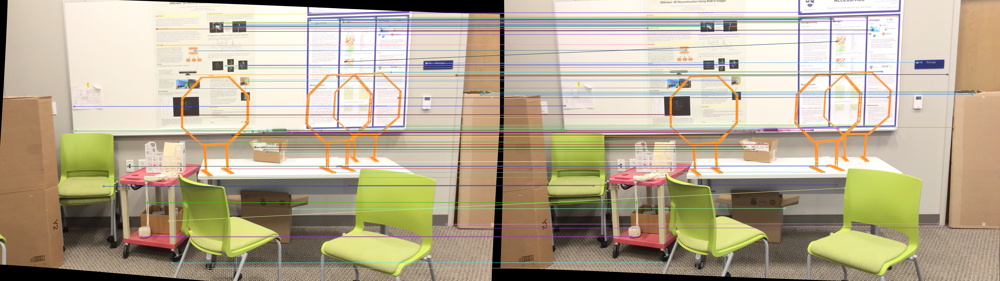


Fundamental mtx
[[-5.58195977e-10 -4.73362683e-07  4.67861062e-04]
 [ 4.75414812e-07  2.12905758e-09 -4.36866681e-03]
 [-4.63855297e-04  4.35865535e-03 -3.75508210e-04]]

Essential mtx
[[-1.96677378e-04 -2.02652026e-01  5.17020357e-02]
 [ 2.03253252e-01  2.69150885e-04 -9.77755413e-01]
 [-5.10021914e-02  9.77926392e-01  4.00291796e-04]]

Translation mtx
[-0.97788497 -0.05179184 -0.20262919]

Rotation mtx
[[ 9.99999470e-01 -8.07763869e-04  6.37930193e-04]
 [ 8.07481267e-04  9.99999576e-01  4.43131236e-04]
 [-6.38287868e-04 -4.42615885e-04  9.99999698e-01]]

Homography mtx 1
[[-3.86289660e-03 -1.84116216e-04 -2.44644227e-01]
 [ 5.20214733e-04 -4.36144688e-03 -5.14545258e-01]
 [ 5.32230528e-07  3.10542941e-08 -4.91878304e-03]]

Homography mtx 2
[[ 8.82547716e-01  4.77514721e-02  8.69683976e+01]
 [-1.19272720e-01  9.95009265e-01  1.17196808e+02]
 [-1.20824728e-04 -6.53739004e-06  1.11952193e+00]]



<ipython-input-6-16d411ad1c21>:28: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  epi_ig_r = cv.line(epi_ig_r, (int(m_x_2), int(m_y_2)), (int(M_x_2), int(M_y_2)), (0,254,254), 2)
<ipython-input-6-16d411ad1c21>:29: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  epi_ig_l = cv.line(epi_ig_l, (int(m_x_1), int(m_y_1)), (int(M_x_1), int(M_y_1)), (0,254,254), 2)



Epipolar lines


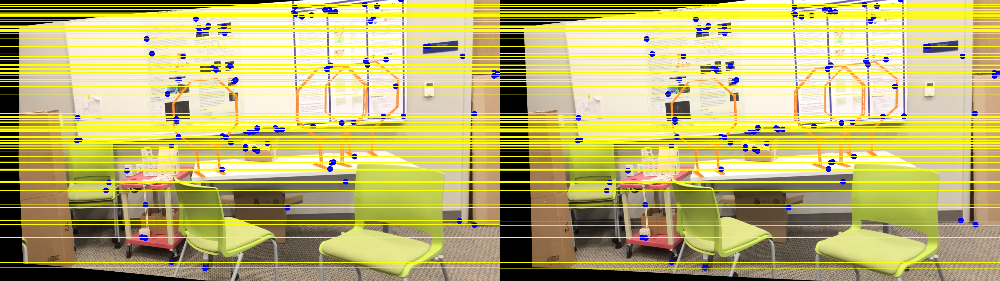

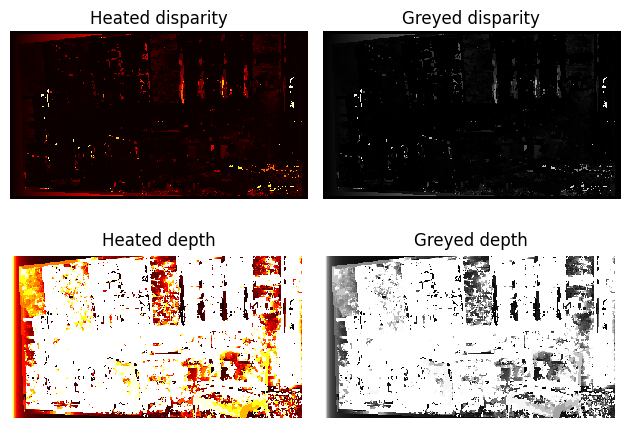

In [9]:
cam1_K = np.array([[1742.11, 0, 804.90], [0 ,1742.11 ,541.22], [0 ,0 ,1]])
cam2_K = np.array([[1742.11, 0, 804.90], [0 ,1742.11 ,541.22], [0 ,0 ,1]])

other_parameters = [0,221.76,1920,1080,100,29,61]
compute(cam1_K, cam2_K, other_parameters, "storageroom")

**TRAPROOM**

Feature matched images


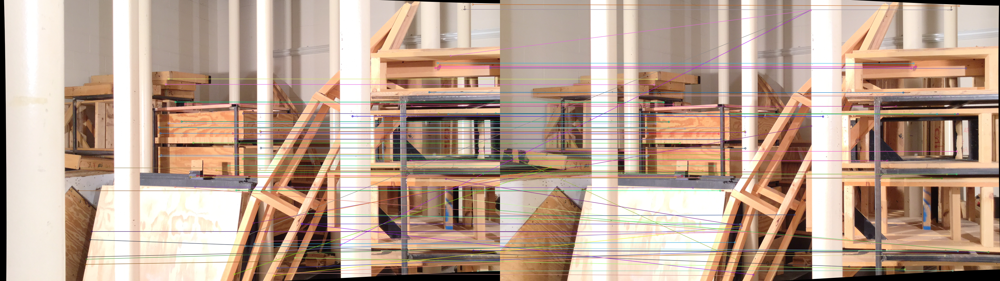


Fundamental mtx
[[ 1.63683704e-10  1.71144285e-07 -7.68502219e-05]
 [-1.76984003e-07 -6.96337827e-09 -2.38440455e-03]
 [ 8.15796078e-05  2.41222925e-03 -1.37472652e-02]]

Essential mtx
[[ 7.80528125e-05  1.14509397e-01  4.87370799e-03]
 [-1.18969592e-01 -2.15680999e-03 -9.92882308e-01]
 [-4.65217483e-03  9.93410136e-01 -2.19200222e-03]]

Translation mtx
[ 0.99341021  0.00512908 -0.11449827]

Rotation mtx
[[ 9.99989750e-01 -4.90047510e-04 -4.50108365e-03]
 [ 4.80014718e-04  9.99997399e-01 -2.22978244e-03]
 [ 4.50216465e-03  2.22759900e-03  9.99987384e-01]]

Homography mtx 1
[[ 2.48103285e-03  4.04158098e-05 -2.48269020e-01]
 [ 7.65544097e-05  2.41373570e-03 -8.22361175e-02]
 [ 1.65763097e-07  7.50340361e-09  2.23277828e-03]]

Homography mtx 2
[[ 1.06382356e+00  6.51427543e-03 -6.47883277e+01]
 [ 2.97879590e-02  1.00020115e+00 -2.87050635e+01]
 [ 6.65024054e-05  4.07224470e-07  9.35937790e-01]]



<ipython-input-6-16d411ad1c21>:28: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  epi_ig_r = cv.line(epi_ig_r, (int(m_x_2), int(m_y_2)), (int(M_x_2), int(M_y_2)), (0,254,254), 2)
<ipython-input-6-16d411ad1c21>:29: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  epi_ig_l = cv.line(epi_ig_l, (int(m_x_1), int(m_y_1)), (int(M_x_1), int(M_y_1)), (0,254,254), 2)



Epipolar lines


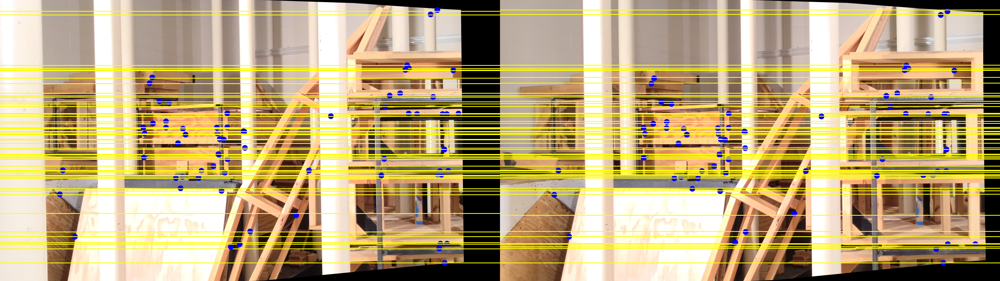

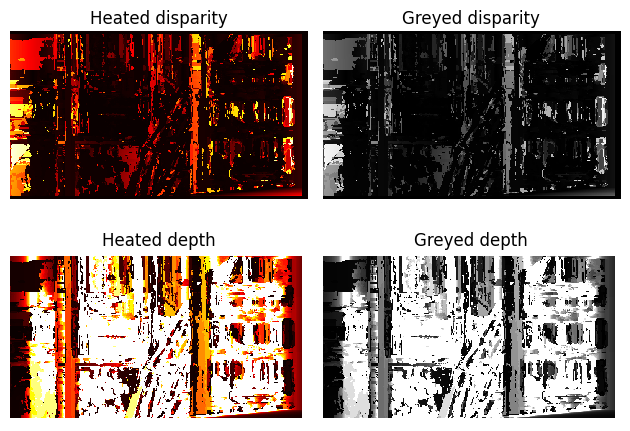

In [11]:
cam1_K = np.array([[1769.02 ,0, 1271.89], [0 ,1769.02 ,527.17],[ 0 ,0 ,1]])
cam2_K = np.array([[1769.02 ,0, 1271.89], [0 ,1769.02 ,527.17],[ 0 ,0 ,1]])

other_parameters = [0,295.44,1920,1080,140,25,118]
compute(cam1_K, cam2_K, other_parameters, "traproom")